# Topik Permasalahan yang dipilih
Permasalahan klasifikasi biner dalam AI muncul ketika sebuah sistem harus memutuskan apakah suatu data termasuk ke dalam satu dari dua kelas, misalnya sehat atau sakit, responsif atau tidak responsif, spam atau bukan spam, serta transaksi normal atau fraud.

 Tantangan utamanya adalah bahwa tidak semua kesalahan prediksi memiliki dampak yang sama. Kesalahan prediksi dibagi menjadi dua jenis, yaitu false positive (FP) ketika sistem memprediksi positif padahal sebenarnya negatif, dan false negative (FN) ketika sistem memprediksi negatif padahal sebenarnya positif. 
 
 Dalam banyak kasus, biaya atau kerugian akibat FP dan FN tidak seimbang. Dengan cara ini, klasifikasi biner dalam AI tidak hanya menjadi masalah teknis prediksi, tetapi juga strategi optimasi keputusan yang mempertimbangkan konteks biaya nyata dari kesalahan.

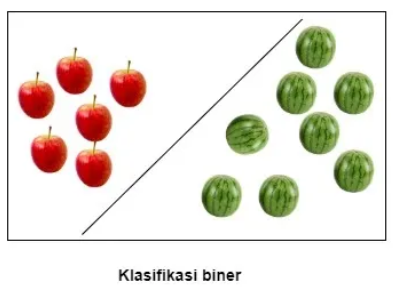

### Dataset yang dipilih dan masalah yang akan diselesaikan
Permasalahan ini berfokus pada pembangunan sebuah model AI untuk
memprediksi apakah seorang pelanggan akan memberikan respons positif
(membeli penawaran) terhadap penawaran pemasaran. 

Ini adalah masalah
klasifikasi biner karena ada dua kemungkinan hasil. Tujuannya adalah untuk
mengidentifikasi pelanggan yang paling mungkin merespons agar penawaran
menjadi lebih efisien secara cost.

### Konteks Dataset
Sebuah supermarket sedang merencanakan penjualan akhir tahun. Mereka ingin meluncurkan penawaran baru — gold membership, yang memberikan diskon 20% untuk semua pembelian, hanya seharga $499 dibandingkan $999 pada hari-hari biasa. Penawaran ini hanya berlaku bagi pelanggan yang sudah ada, dan kampanye melalui panggilan telepon sedang direncanakan untuk mereka.

 Pihak manajemen merasa bahwa cara terbaik untuk mengurangi biaya kampanye adalah dengan membuat model prediktif yang dapat mengklasifikasikan pelanggan yang kemungkinan besar akan membeli penawaran tersebut.

 
Supermarket besar tersebut ingin memprediksi kemungkinan pelanggan memberikan respons positif serta mengidentifikasi berbagai faktor yang memengaruhi respons pelanggan.

### About the Dataset
The data description is as follows:

- **Response (target)**: 1 if customer accepted the offer in the last campaign, 0 otherwise
- **ID**: Unique ID of each customer
- **Year_Birth**: Age of the customer
- **Complain**: 1 if the customer complained in the last 2 years
- **Dt_Customer**: Date of customer's enrollment with the company
- **Education**: Customer's level of education
- **Marital**: Customer's marital status
- **Kidhome**: Number of small children in customer's household
- **Teenhome**: Number of teenagers in customer's household
- **Income**: Customer's yearly household income
- **MntFishProducts**: The amount spent on fish products in the last 2 years
- **MntMeatProducts**: The amount spent on meat products in the last 2 years
- **MntFruits**: The amount spent on fruits products in the last 2 years
- **MntSweetProducts**: Amount spent on sweet products in the last 2 years
- **MntWines**: The amount spent on wine products in the last 2 years
- **MntGoldProds**: The amount spent on gold products in the last 2 years
- **NumDealsPurchases**: Number of purchases made with discount
- **NumCatalogPurchases**: Number of purchases made using catalog (buying goods to be shipped through the mail)
- **NumStorePurchases**: Number of purchases made directly in stores
- **NumWebPurchases**: Number of purchases made through the company's website
- **NumWebVisitsMonth**: Number of visits to company's website in the last month
- **Recency**: Number of days since the last purchase


# Exploratory Data Analysis
Ini adalah tahap untuk memahami data secara lebih lanjut dan merangkum karakteristik dari data yang dimiliki

### Install Requirement & Load Dataset

In [1]:
# import sys
# !{sys.executable} -m pip install pandas
# !{sys.executable} -m pip install matplotlib
# !{sys.executable} -m pip install seaborn
# !{sys.executable} -m pip install scikit-learn
# !{sys.executable} -m pip install imblearn

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sys
sys.path.append("src")

In [3]:
df = pd.read_csv('../dataset/dataset.csv')

In [4]:
df.head()

,Id,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain
0,1826,1970,Graduation,Divorced,84835.0,0,0,6/16/2014,0,189,...,111,189,218,1,4,4,6,1,1,0
1,1,1961,Graduation,Single,57091.0,0,0,6/15/2014,0,464,...,7,0,37,1,7,3,7,5,1,0
2,10476,1958,Graduation,Married,67267.0,0,1,5/13/2014,0,134,...,15,2,30,1,3,2,5,2,0,0
3,1386,1967,Graduation,Together,32474.0,1,1,11/5/2014,0,10,...,0,0,0,1,1,0,2,7,0,0
4,5371,1989,Graduation,Single,21474.0,1,0,8/4/2014,0,6,...,11,0,34,2,3,1,2,7,1,0


### Struktur Data 
Melihat fitur mana saja yang numerik dan mana saja yang kategorikal

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Id                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

### 1. Statistik Dasar Fitur
**Fitur Numerik**

In [6]:
df.describe()

,Id,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Response,Complain
count,2240.000000,2240.000000,2216.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,5592.159821,1968.805804,52247.251354,0.444196,0.506250,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,2.325000,4.084821,2.662054,5.790179,5.316518,0.149107,0.009375
std,3246.662198,11.984069,25173.076661,0.538398,0.544538,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,1.932238,2.778714,2.923101,3.250958,2.426645,0.356274,0.096391
min,0.000000,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2828.250000,1959.000000,35303.000000,0.000000,0.000000,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000
50%,5458.500000,1970.000000,51381.500000,0.000000,0.000000,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000
75%,8427.750000,1977.000000,68522.000000,1.000000,1.000000,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000
max,11191.000000,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000


**Fitur Kategorikal**

In [7]:
categorical_cols = df.select_dtypes(include=['object', 'category']).columns.drop('Dt_Customer')
for col in categorical_cols:
    print(df[col].nunique())
    print(df[col].value_counts())

5
Education
Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: count, dtype: int64
8
Marital_Status
Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
YOLO          2
Absurd        2
Name: count, dtype: int64


### 2. Distribusi Data untuk setiap fitur
Histogram akan digunakan untuk melihat persebaran data
##### Distribusi Fitur Numerik

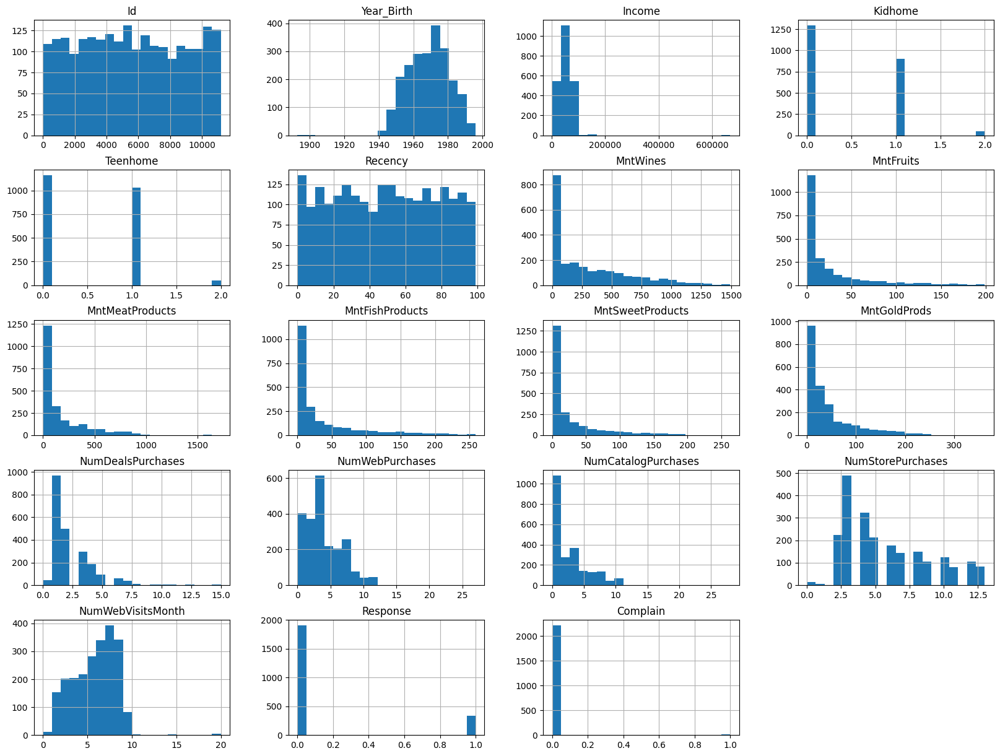

In [8]:
df.hist(bins=20, figsize=(20, 15))
plt.show()

##### Distribusi Fitur Kategorikal

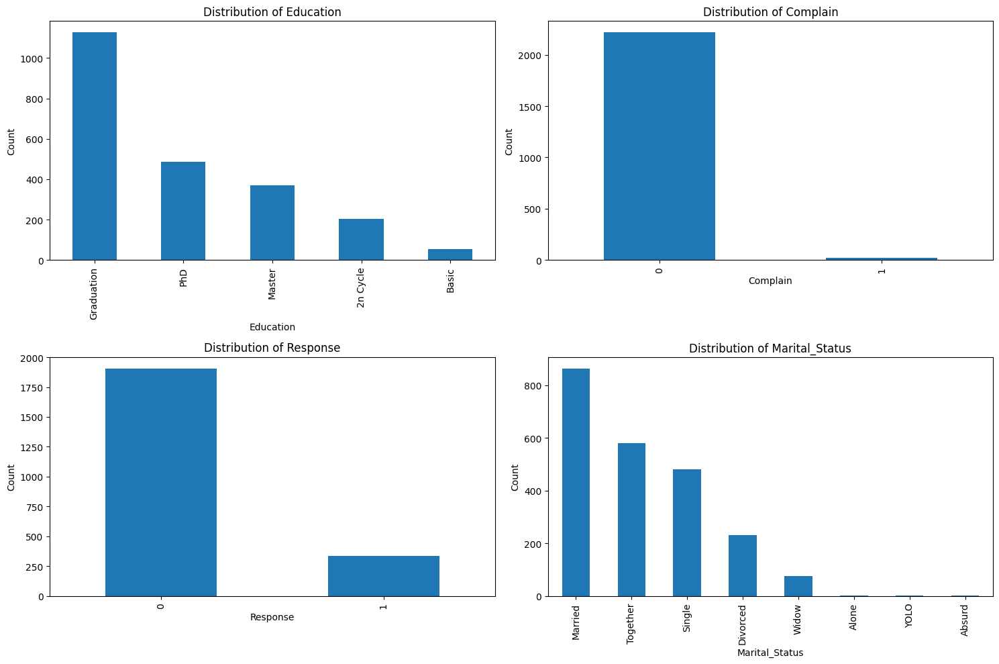

In [9]:
categorical_columns = ['Education', 'Complain', 'Response', 'Marital_Status']

fig, axes = plt.subplots(2, 2, figsize=(15, 10))

for i, col in enumerate(categorical_columns):
    df[col].value_counts().plot(kind='bar', ax=axes[i//2, i%2])
    axes[i//2, i%2].set_title(f'Distribution of {col}')
    axes[i//2, i%2].set_ylabel('Count')

plt.tight_layout()
plt.show()

##### Pengecekan Skewness (Kecondongan) Data dari Setiap Fitur

In [10]:
# Hitung skewness dengan pandas langsung
print("\nSkewness tiap fitur (pandas):")
print(df.skew(numeric_only=True))


Skewness tiap fitur (pandas):
Id                      0.039832
Year_Birth             -0.349944
Income                  6.763487
Kidhome                 0.635288
Teenhome                0.407115
Recency                -0.001987
MntWines                1.175771
MntFruits               2.102063
MntMeatProducts         2.083233
MntFishProducts         1.919769
MntSweetProducts        2.136081
MntGoldProds            1.886106
NumDealsPurchases       2.418569
NumWebPurchases         1.382794
NumCatalogPurchases     1.880989
NumStorePurchases       0.702237
NumWebVisitsMonth       0.207926
Response                1.971555
Complain               10.188972
dtype: float64


### 3. Pengecekan Outlier
Pengecekan outlier akan dilihat dari Box Plot

##### Fitur Numerik

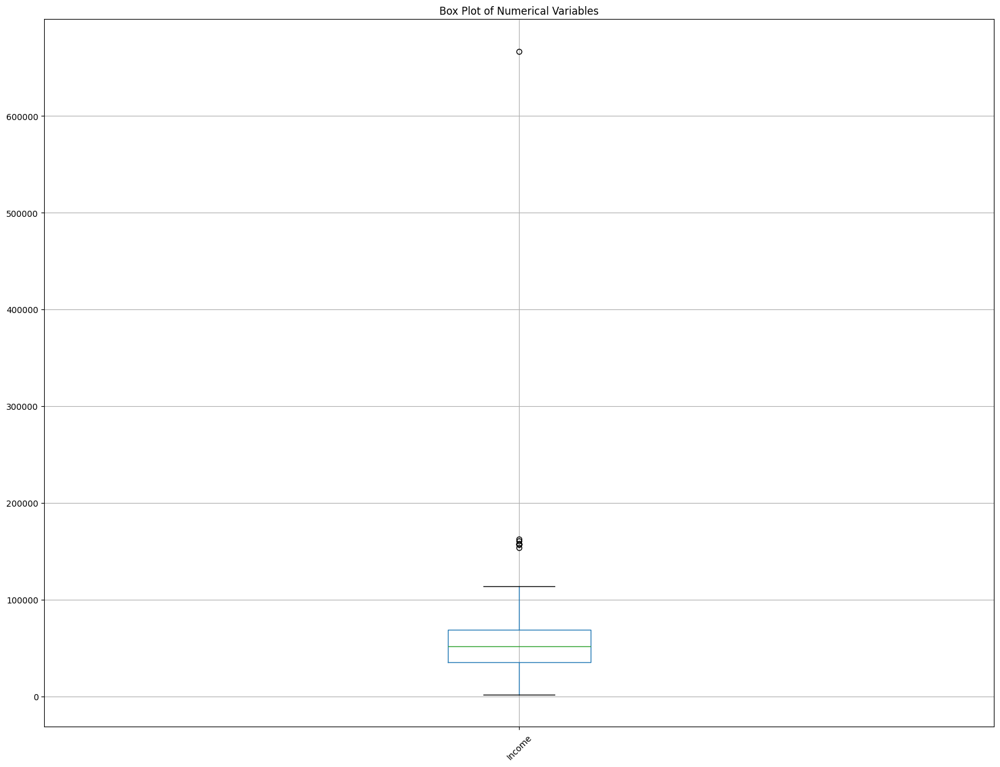

In [11]:
# Income
numerical_columns = ['Income']

plt.figure(figsize=(20, 15))
df[numerical_columns].boxplot(rot=45)
plt.title('Box Plot of Numerical Variables')
plt.show()

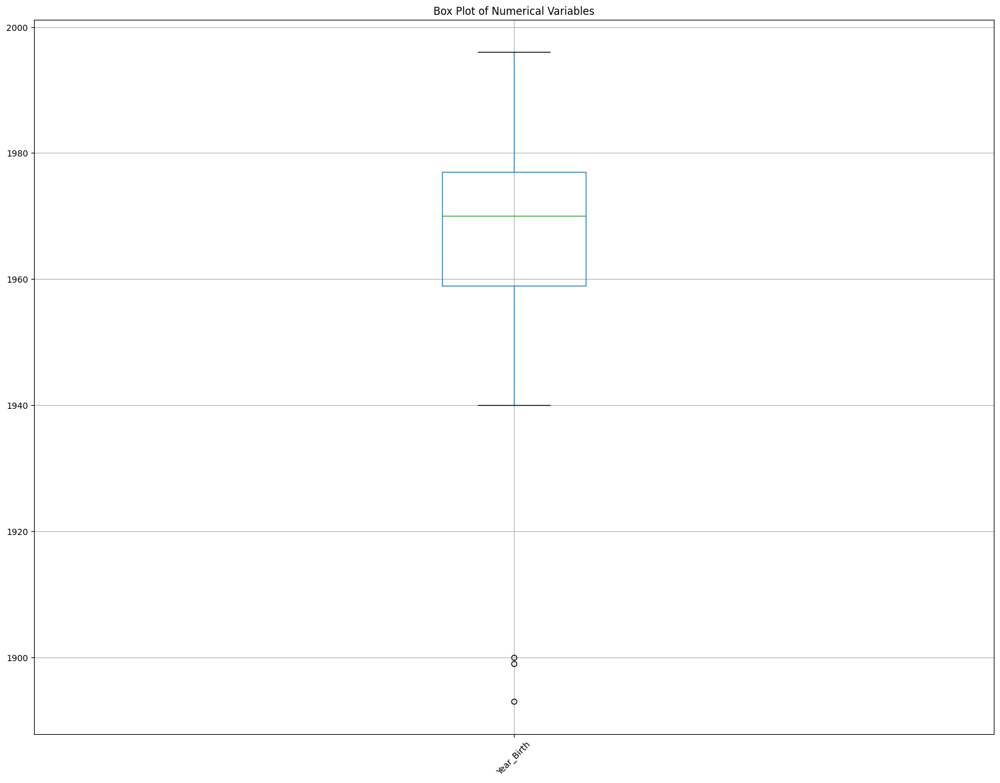

In [12]:
# Birth Year
numerical_columns = ['Year_Birth']

plt.figure(figsize=(20, 15))
df[numerical_columns].boxplot(rot=45)
plt.title('Box Plot of Numerical Variables')
plt.show()

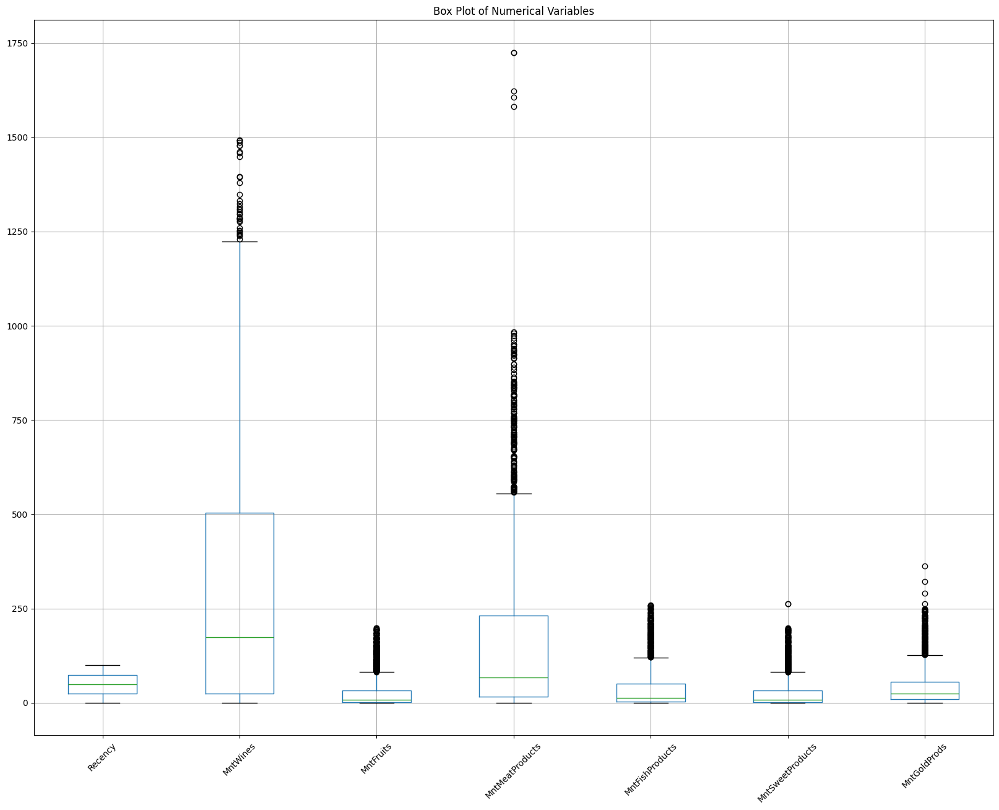

In [13]:
numerical_columns1 = ['Recency', 'MntWines', 'MntFruits', 
                     'MntMeatProducts', 'MntFishProducts', 
                     'MntSweetProducts', 'MntGoldProds']

plt.figure(figsize=(20, 15))
df[numerical_columns1].boxplot(rot=45)
plt.title('Box Plot of Numerical Variables')
plt.show()

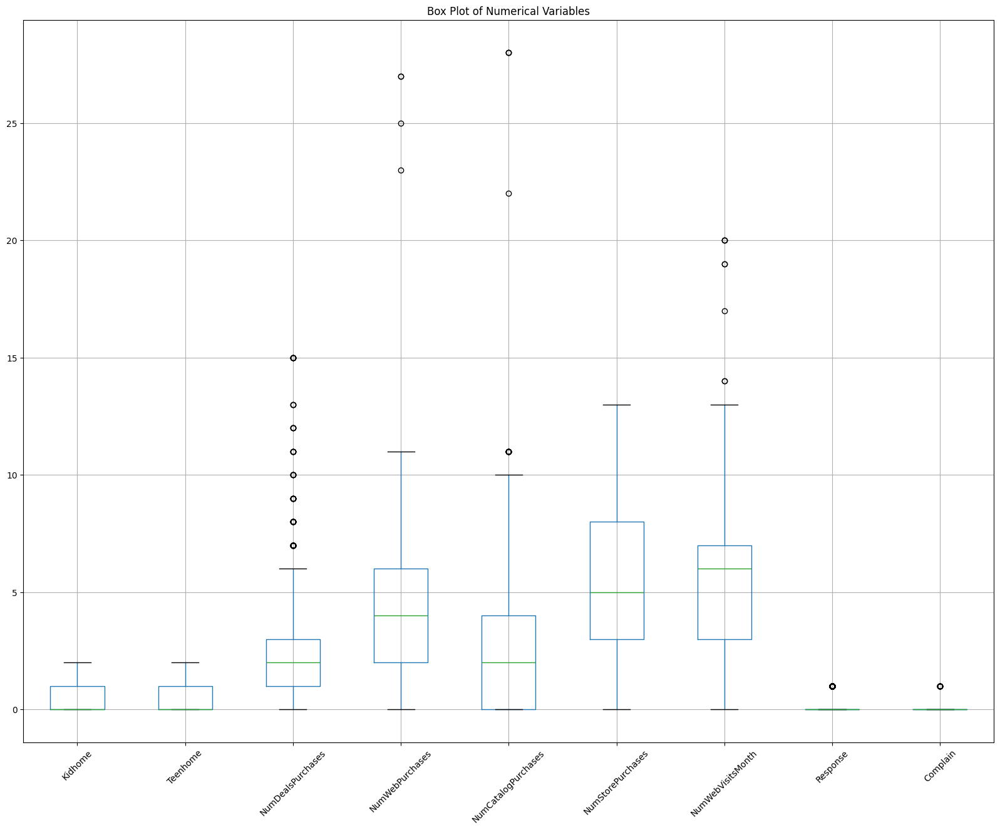

In [14]:
numerical_columns2 = df.columns[df.dtypes != 'object'].drop(['Income', 'Id', 'Year_Birth', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds'])

plt.figure(figsize=(20, 15))
df[numerical_columns2].boxplot(rot=45)
plt.title('Box Plot of Numerical Variables')
plt.show()

##### Top and Bottom Values

Pengecekan data top sekaligus pengecekan potensi outlier nya

In [15]:
# Top 10 values for Income
top_10_income = df.nlargest(10, 'Income')
print("Top 10 values for Income:")
print(top_10_income[['Id', 'Income']])

# Top 10 values for Income
top_10_income = df.nlargest(10, 'MntMeatProducts')
print("Top 10 values for MntMeatProducts:")
print(top_10_income[['Id', 'MntMeatProducts']])

# Bottom 10 values for Year_Birth
bottom_10_year_birth = df.nsmallest(10, 'Year_Birth')
print("Bottom 10 values for Year_Birth:")
print(bottom_10_year_birth[['Id', 'Year_Birth']])

Top 10 values for Income:
         Id    Income
527    9432  666666.0
731    1503  162397.0
497    1501  160803.0
853    5336  157733.0
2204   8475  157243.0
325    4931  157146.0
1925  11181  156924.0
1826   5555  153924.0
210    4619  113734.0
832    4611  105471.0
Top 10 values for MntMeatProducts:
        Id  MntMeatProducts
325   4931             1725
961   5376             1725
497   1501             1622
1213  8720             1607
2204  8475             1582
1921  1065              984
53    1619              981
994   4947              974
2021  3104              968
1338  9220              961
Bottom 10 values for Year_Birth:
         Id  Year_Birth
513   11004        1893
827    1150        1899
2233   7829        1900
2171   6663        1940
1740   6932        1941
1202   4994        1943
1208   2968        1943
1209   8800        1943
1350   1453        1943
1475   6142        1943


#### Fitur Kategorikal
Outlier pada Fitur Kategorikal adalah data-data aneh yang tidak sesuai konteks daripada fiturnya itu sendiri

Pada fitur di bawah, yaitu Marital_Status, YOLO dan Absurd bisa dianggap outlier

In [16]:
categorical_cols = df.select_dtypes(include=['object', 'category']).columns.drop('Dt_Customer')
for col in categorical_cols:
    print(df[col].nunique())
    print(df[col].value_counts())

5
Education
Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: count, dtype: int64
8
Marital_Status
Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
YOLO          2
Absurd        2
Name: count, dtype: int64


### 4. Pengecekan Korelasi Fitur terhadap Fitur Target
Hal ini akan berguna nantinya untuk pemilihan fitur yang digunakan

#### Pair Plot
Untuk melihat korelasi 2 fitur data secara grafik, apakah data berkorelasi linear, parabolik, atau tidak

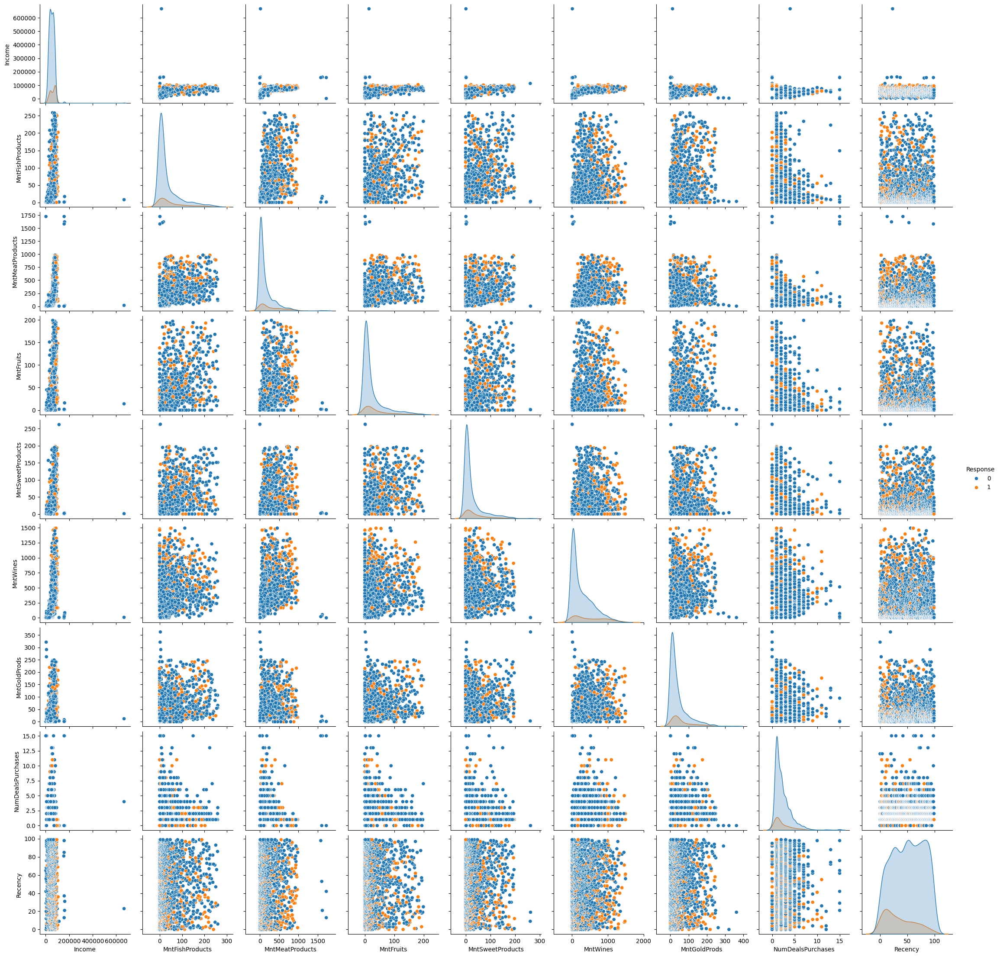

In [17]:
import seaborn as sns

# Select a subset of columns for the pair plot
pairplot_columns = ['Income', 'MntFishProducts', 'MntMeatProducts', 'MntFruits', 'MntSweetProducts',
                    'MntWines', 'MntGoldProds', 'NumDealsPurchases', 'Recency', 'Response']

# Plot pair plot
sns.pairplot(df[pairplot_columns], hue='Response')
plt.show()


#### Correlation Matrix
Melihat korelasi para fitur terhadap fitur target secara numerik dengan interval 0 sampai 1

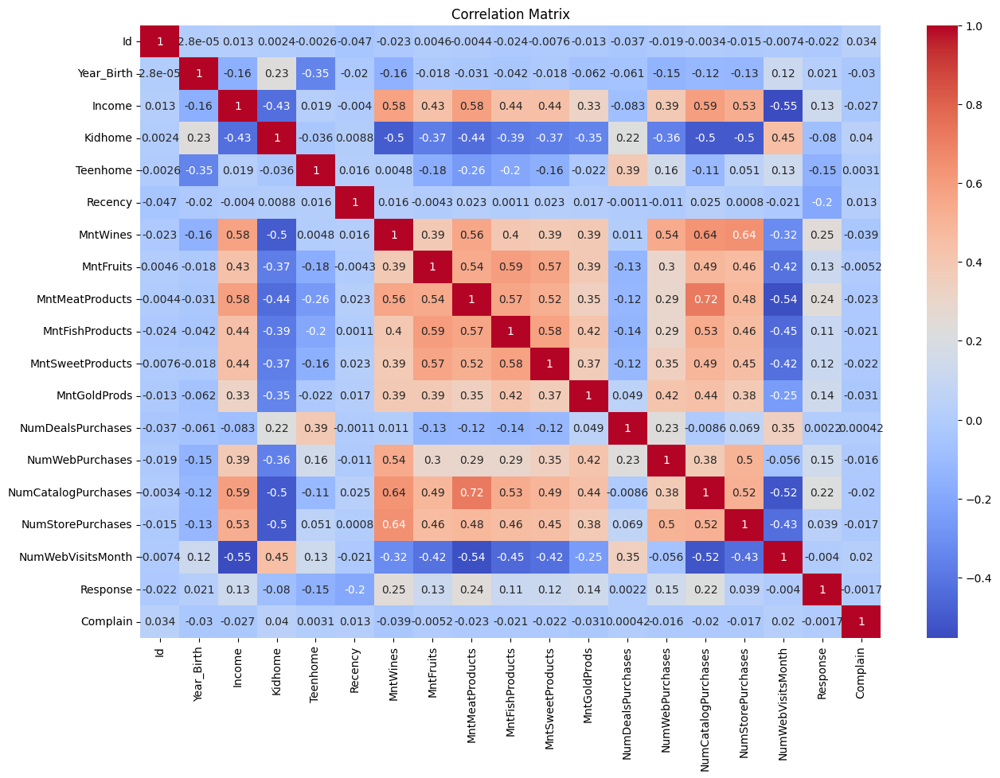

In [18]:
correlation_matrix = df.select_dtypes(include=[np.number]).corr()

plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

### 5. Tool yang mempermudah EDA : YbProfiling
Dengan library profiling ini, EDA bisa dilakukan dengan 1 line dan hasil return berupa HTML interaktif yang bisa di-eksplor.
Semua proses di atas dapat dilakukan sekaligus melalui profiling

In [19]:
from ydata_profiling import ProfileReport

profile = ProfileReport(df, title="Laporan EDA dengan Ydata Profiling", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 22/22 [00:00<00:00, 1235.80it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Data Preprocessing
Tahap pengolahan data sedemikian sehingga data sudah dalam format atau kondisi yang tepat untuk digunakan ke tahap selanjutnya

### 1. Handling Missing Values (Data Cleaning)
Data cleaning dipilih karena baris data yang memiliki nilai kosong akan menyebabkan error saat modelling sehingga harus di-handle, di sini kita isi data kosong dengan nilai rata-rata

In [20]:
missing_values = df.isnull().sum()
missing_values

# Fill missing values (diisi dengan mean)
df['Income'].fillna(df['Income'].mean(), inplace=True)

# Memastikan tidak ada data kosong lagi
df.isnull().sum()

C:\Users\saman\AppData\Local\Temp\ipykernel_43292\1071982476.py:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Income'].fillna(df['Income'].mean(), inplace=True)


Id                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
Response               0
Complain               0
dtype: int64

### 2. Handling Outliers (Data Cleaning)
Outlier akan membuat performa model dalam prediksi turun

In [21]:
# Remove rows where Year_Birth is less than 1920
df = df[df['Year_Birth'] >= 1940]

# Remove rows where Income is greater than or equal to 400000
df = df[df['Income'] <= 400000]

# Remove rows where MntMeatProducts is greater than or equal to 1000
df = df[df['MntMeatProducts'] <= 1000]

### 3. Encoding Categorical Variables (Data Transformation)

Data Object/String tidak bisa diolah oleh model, sehingga data kategorikal harus ditransformasikan ke numerik dengan encoding. Yang digunakan adalah one-hot encoding

In [22]:
df = pd.get_dummies(df, columns=['Education', 'Marital_Status'], drop_first=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2231 entries, 0 to 2239
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Id                       2231 non-null   int64  
 1   Year_Birth               2231 non-null   int64  
 2   Income                   2231 non-null   float64
 3   Kidhome                  2231 non-null   int64  
 4   Teenhome                 2231 non-null   int64  
 5   Dt_Customer              2231 non-null   object 
 6   Recency                  2231 non-null   int64  
 7   MntWines                 2231 non-null   int64  
 8   MntFruits                2231 non-null   int64  
 9   MntMeatProducts          2231 non-null   int64  
 10  MntFishProducts          2231 non-null   int64  
 11  MntSweetProducts         2231 non-null   int64  
 12  MntGoldProds             2231 non-null   int64  
 13  NumDealsPurchases        2231 non-null   int64  
 14  NumWebPurchases          2231

In [23]:
df.loc[df["Marital_Status_Alone"] == True, "Marital_Status_Single"] = True
df = df.drop(columns=["Marital_Status_Alone"])

df.loc[df["Marital_Status_Together"] == True, "Marital_Status_Married"] = True
df = df.drop(columns=["Marital_Status_Together"])

df.loc[df["Marital_Status_Widow"] == True, "Marital_Status_Divorced"] = True
df = df.drop(columns=["Marital_Status_Widow"])

df = df.drop(columns=['Marital_Status_YOLO'])

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2231 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Id                       2231 non-null   int64  
 1   Year_Birth               2231 non-null   int64  
 2   Income                   2231 non-null   float64
 3   Kidhome                  2231 non-null   int64  
 4   Teenhome                 2231 non-null   int64  
 5   Dt_Customer              2231 non-null   object 
 6   Recency                  2231 non-null   int64  
 7   MntWines                 2231 non-null   int64  
 8   MntFruits                2231 non-null   int64  
 9   MntMeatProducts          2231 non-null   int64  
 10  MntFishProducts          2231 non-null   int64  
 11  MntSweetProducts         2231 non-null   int64  
 12  MntGoldProds             2231 non-null   int64  
 13  NumDealsPurchases        2231 non-null   int64  
 14  NumWebPurchases          2231

### 4. Feature Engineering

Fitur Engineering dilakukan untuk meningkatkan performa model dan membuat prediksi lebih akurat.

In [24]:
# Create Age feature
df['Age'] = 2025 - df['Year_Birth']
df.drop('Year_Birth', axis=1, inplace=True)

# Income per capita
df['Household_size'] = df['Kidhome'] + df['Teenhome'] + 1
df['per_capita'] = df['Income'] / df['Household_size']

# Kids Count
df['Kids_Count'] = df['Kidhome'] + df['Teenhome']

# Total & Average Mount
df['totalMnt'] = df['MntWines'] + df['MntFruits'] + df['MntMeatProducts'] + df['MntFishProducts'] + df['MntSweetProducts'] + df['MntGoldProds']
df['averageMnt'] = df['totalMnt'] / 6

# Total Purchase
df['total_purchase'] = df['NumDealsPurchases'] + df['NumWebPurchases'] + df['NumCatalogPurchases'] + df['NumStorePurchases']

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2231 entries, 0 to 2239
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Id                       2231 non-null   int64  
 1   Income                   2231 non-null   float64
 2   Kidhome                  2231 non-null   int64  
 3   Teenhome                 2231 non-null   int64  
 4   Dt_Customer              2231 non-null   object 
 5   Recency                  2231 non-null   int64  
 6   MntWines                 2231 non-null   int64  
 7   MntFruits                2231 non-null   int64  
 8   MntMeatProducts          2231 non-null   int64  
 9   MntFishProducts          2231 non-null   int64  
 10  MntSweetProducts         2231 non-null   int64  
 11  MntGoldProds             2231 non-null   int64  
 12  NumDealsPurchases        2231 non-null   int64  
 13  NumWebPurchases          2231 non-null   int64  
 14  NumCatalogPurchases      2231

### 5. Feature Selection
Pemilihan fitur bisa dilakukan secara manual dengan melihat korelasi tiap fitur terhadap target atau bisa juga secara otomatis dengan library sklearn

Contoh secara otomatis dengan sklearn:

In [25]:
# from sklearn.feature_selection import RFE

# for i in range(1, 20):
#     rfe = RFE(Model(), n_features_to_select=i)
#     rfe.fit(df.drop('Response', axis=1), df['Response'])
#     print(f"Number of features: {i}, Selected features: {df.drop('Response', axis=1).columns[rfe.support_]}")

##### Kita akan melakukan Feature Selection dengan PCA di bawah ini

### 6. Balancing Target Feature & Splitting the Data (Undersampling)

Karena dirasa dataset imbalanced, yaitu jumlah response negatif jauh lebih banyak daripada response positif. Maka dilakukan balancing dengan **undersampling**.
Nanti akan diuji dengan performa model apakah balancing ini menambah performa atau menurunkan dan akan diputuskan kemudian digunakan atau tidak.

In [26]:
df = df.drop([ 'Id', 'Dt_Customer'], axis=1)
df = df.astype({col: int for col in df.select_dtypes('bool').columns})

In [27]:
from sklearn.model_selection import train_test_split

X = df.drop(['Response'], axis=1)
y = df['Response']

In [28]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Display the shape of the training and testing sets
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((1784, 30), (447, 30), (1784,), (447,))

In [29]:
X_train = X_train.to_numpy()
X_test = X_test.to_numpy()
y_train = y_train.to_numpy()
y_test = y_test.to_numpy()

In [30]:
# from imblearn.over_sampling import RandomOverSampler

# # Oversampler
# ros = RandomOverSampler(random_state=42)
# X_res, y_res = ros.fit_resample(X_train, y_train)
# X_res.shape, y_res.shape

### 7. Normalisasi dan Standardisasi data (hasilnya untuk beberapa model saja)

Model dengan algoritma pohon keputusan seperti Decision Tree tentunya tidak masalah berhubungan dengan angka yang beragam. Karena baginya hanya digunakan untuk penentuan threshold pada keputusan. Tetapi untuk beberapa fitur yang melakukan klasifikasi dengan ukuran kedekatan data, pembobotan fitur dan evaluasi dengan gradient descent, data yang terlalu beragam dan jarak maksimum ke minimumnya jauh akan terplot dengan kurang bagus

In [31]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Normalization (Min-Max Scaling ke rentang 0-1)
scaler_norm = MinMaxScaler()
X_train_norm = scaler_norm.fit_transform(X_train)
X_test_norm = scaler_norm.transform(X_test)
print("\nNormalization (0-1):\n", X_train_norm, X_test_norm)

# --- Standardization (Z-score scaling) ---
scaler_std = StandardScaler()
X_train_std = scaler_std.fit_transform(X_train)
X_test_std = scaler_std.transform(X_test)
print("\nStandardization (mean=0, std=1):\n", X_train_std, X_test_std)


Normalization (0-1):
 [[0.35743241 0.5        0.5        ... 0.26002382 0.26002382 0.61538462]
 [0.16889767 0.5        0.5        ... 0.00555776 0.00555776 0.1025641 ]
 [0.39436397 0.5        0.5        ... 0.12147678 0.12147678 0.48717949]
 ...
 [0.08147802 0.5        0.5        ... 0.0186582  0.0186582  0.30769231]
 [0.23988155 0.5        0.         ... 0.17070266 0.17070266 0.51282051]
 [0.46301792 0.         0.5        ... 0.26359667 0.26359667 0.51282051]] [[0.24228093 0.5        0.         ... 0.01032156 0.01032156 0.12820513]
 [0.40339955 0.         0.5        ... 0.38507344 0.38507344 0.69230769]
 [0.22309849 0.5        0.5        ... 0.00674871 0.00674871 0.1025641 ]
 ...
 [0.48574261 0.         0.         ... 0.69511711 0.69511711 0.64102564]
 [0.14430399 0.         0.         ... 0.10400953 0.10400953 0.30769231]
 [0.41506813 0.         0.         ... 0.40611354 0.40611354 0.46153846]]

Standardization (mean=0, std=1):
 [[ 0.40940874  1.05071727  0.8671658  ...  0.0965175  

##### Dimensionality Reduction oleh PCA

In [32]:
from unsupervised_learning.PCA import PCA
model = PCA(n_Multiplier=0.8)
model.fit(X_train)

X_train = model.transform(X_train)
X_test = model.transform(X_test)

X_train_norm = scaler_norm.fit_transform(X_train)
X_test_norm = scaler_norm.transform(X_test)

X_train_std = scaler_std.fit_transform(X_train)
X_test_std = scaler_std.transform(X_test)

print(X_train.shape)

(1784, 24)


# Validasi
Validasi dibahas sebelum Modelling karena ada konsep yang harus dijelaskan dan di setiap model di bawah akan sekaligus dilakukan validasi setelahnya untuk membandingkan

### Metric yang dipilih : Confusion Matrix
Confusion matrix akan memberikan ringkasan hasil prediksi pada set data pengujian dengan menunjukkan jumlah true positives, true negatives, false positives, dan false negatives.

TP : diprediksi positive, benar positif

FP : diprediksi positive, aslinya negatif

FN : diprediksi negative, aslinya positif

TN : diprediksi negative, benar negatif

Alasan : Matrix ini dipilih karena tujuan awal prediksi pada data ini adalah mendapat target positif sebanyak mungkin dengan biaya seminimum mungkin. Dengan mengetahui pasti elemen dari confusion matrix, maka penawaran bisa dilakukan pada orang dengan data terindikasi true positives dan false negatives

Sebagai tambahan, metriks pelengkap confusion matrix seperti accuracy score yanhg mengukur seberapa sering model membuat prediksi yang benar dan classification report (Precission, Recall, F1-Score) akan digunakan.

In [33]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

# Modeling & Validating


### Hold-out Validation Function

In [34]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
# Fungsi Modelling dan testing
def holdOut_Validating(modelcik, X_train, y_train, X_test, y_test):
    model = modelcik
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    unique_labels = np.unique(y_test)
    conf_matrix = (confusion_matrix(y_test, y_pred, labels=unique_labels))

    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['Not Purchased', 'Purchased'], 
                yticklabels=['Not Purchased', 'Purchased'])
    plt.ylabel('Actual')
    plt.xlabel('Predicted')
    plt.title('Confusion Matrix')
    plt.show()
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred))
    print("\nAccuracy Score:")
    print(accuracy_score(y_test, y_pred))

### K-Fold Validation Function

In [35]:
from sklearn.model_selection import cross_val_score, StratifiedKFold

def kFold_Validating(model, X, y, folds=5, showfold=2):
    skf = StratifiedKFold(n_splits=folds, shuffle=True, random_state=42)
    all_acc = []
    fold = 1
    
    for train_idx, test_idx in skf.split(X, y):
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]
        
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        
        acc = accuracy_score(y_test, y_pred)
        all_acc.append(acc)
        
        # Confusion Matrix
        if fold == showfold:
            conf_matrix = confusion_matrix(y_test, y_pred)
            plt.figure(figsize=(8, 6))
            sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Purchased', 'Purchased'], yticklabels=['Not Purchased', 'Purchased'])
            plt.ylabel('Actual')
            plt.xlabel('Predicted')
            plt.title('Confusion Matrix')
            plt.show()
            print(conf_matrix)
            print(f"Fold {showfold} Report:")
            print(classification_report(y_test, y_pred))
            print("-"*50)
        fold += 1
    
    print(f"\nMean Accuracy across {folds} folds: {np.mean(all_acc):.4f} (+/- {np.std(all_acc):.4f})")



### 1. KNN
Data yang akan dipakai adalah yang sudah dinormalisasi (Hasil meningkat pesat, yang tadinya akurasi 0.803 menjadi 0.843)

NN menghitung jarak antar titik (misalnya Euclidean).
Jika ada fitur dengan skala besar (contoh: umur 20–60 vs pendapatan 1.000.000–10.000.000), maka fitur besar akan mendominasi jarak.
Normalisasi ke rentang [0,1] membuat semua fitur punya kontribusi seimbang.

### Hold-out Validation
#### Hasil buatan from scratch


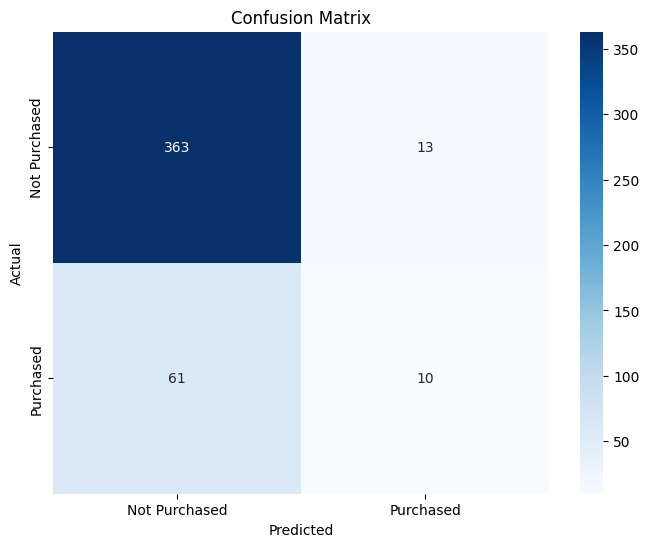


Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.97      0.91       376
           1       0.43      0.14      0.21        71

    accuracy                           0.83       447
   macro avg       0.65      0.55      0.56       447
weighted avg       0.79      0.83      0.80       447


Accuracy Score:
0.8344519015659956


In [36]:
from supervised_learning.KNN import KNN
holdOut_Validating(KNN(k=5, method='euclidean'), X_train, y_train, X_test, y_test)

#### Hasil dari Library Scikit-Learn

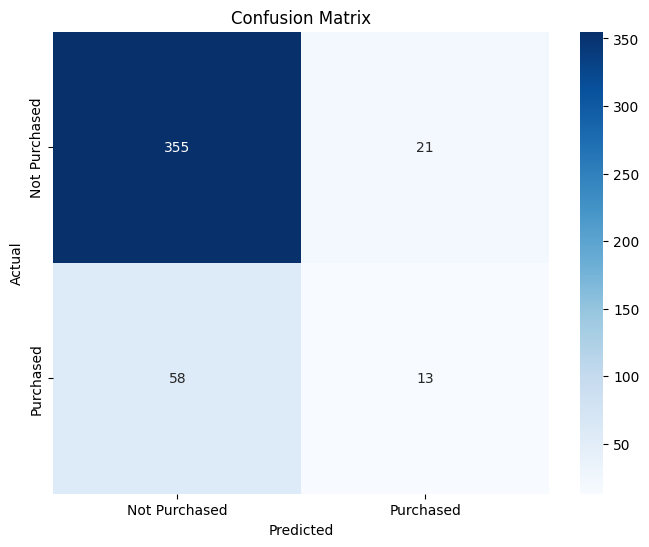


Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.94      0.90       376
           1       0.38      0.18      0.25        71

    accuracy                           0.82       447
   macro avg       0.62      0.56      0.57       447
weighted avg       0.78      0.82      0.80       447


Accuracy Score:
0.8232662192393736


In [37]:
from sklearn.neighbors import KNeighborsClassifier
holdOut_Validating(KNeighborsClassifier(n_neighbors=5, metric='euclidean'), X_train_norm, y_train, X_test_norm, y_test)

### K-Fold Validation
#### Hasil buatan from scratch

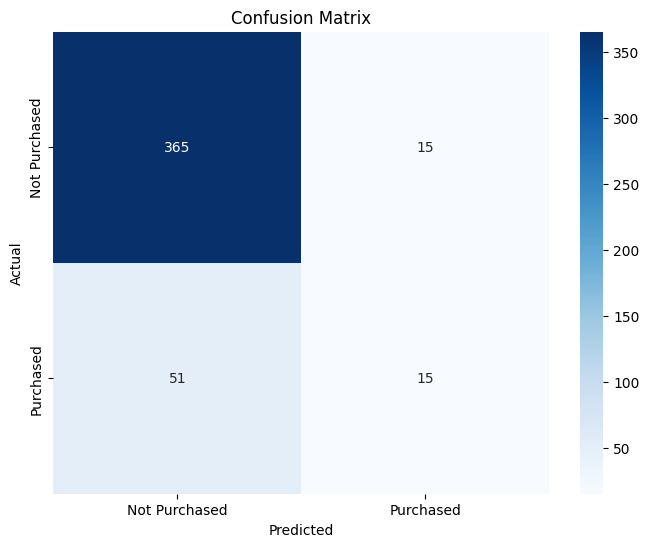

[[365  15]
 [ 51  15]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.88      0.96      0.92       380
           1       0.50      0.23      0.31        66

    accuracy                           0.85       446
   macro avg       0.69      0.59      0.61       446
weighted avg       0.82      0.85      0.83       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8427 (+/- 0.0100)


In [38]:
kFold_Validating(KNN(k=5, method='manhattan'), np.vstack((X_train_norm, X_test_norm)), np.hstack((y_train, y_test)), folds=5)

#### Hasil library scikitlearn

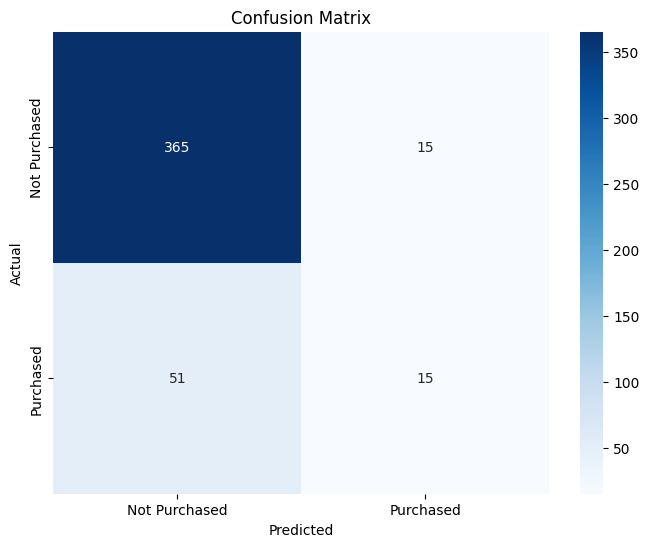

[[365  15]
 [ 51  15]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.88      0.96      0.92       380
           1       0.50      0.23      0.31        66

    accuracy                           0.85       446
   macro avg       0.69      0.59      0.61       446
weighted avg       0.82      0.85      0.83       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8427 (+/- 0.0100)


In [39]:
kFold_Validating(KNeighborsClassifier(n_neighbors=5, metric='manhattan'), np.vstack((X_train_norm, X_test_norm)), np.hstack((y_train, y_test)), folds=5)

### 2. Logistic Regression
Dataset yang digunakan adalah hasil standardisasi (Hasil akurasi model meningkat pesat, tadinya di kisaran 0.56 menjadi 0.83). 

Logistic Regression menggunakan optimisasi berbasis gradient descent.
Jika fitur berbeda skala, gradien jadi tidak stabil, menghambat konvergensi.
Dengan standarisasi (mean=0, std=1), semua fitur berada pada skala yang mirip sehingga training lebih cepat dan stabil.
### Hold-out Validation
##### Model from scratch

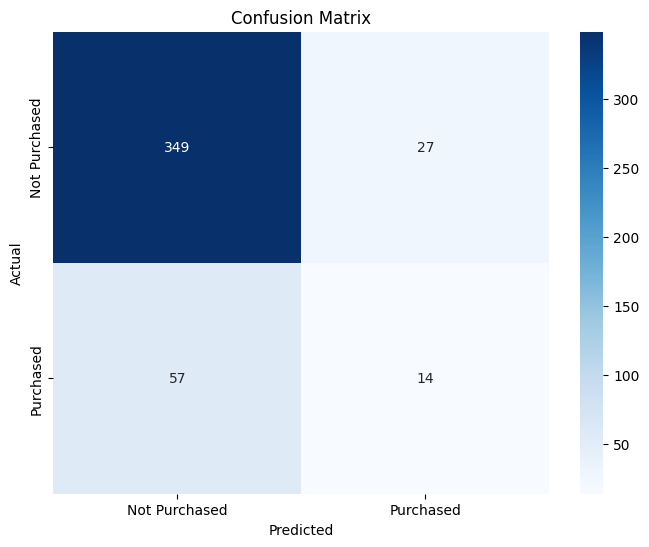


Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.93      0.89       376
           1       0.34      0.20      0.25        71

    accuracy                           0.81       447
   macro avg       0.60      0.56      0.57       447
weighted avg       0.78      0.81      0.79       447


Accuracy Score:
0.8120805369127517


In [40]:
from supervised_learning.LogisticRegression import LogisticRegression
holdOut_Validating(LogisticRegression(learnRate=0.0001, iteration=10000, regTerm='l2', regLambda=0), X_train_std, y_train, X_test_std, y_test)

##### Model Scikit Learn

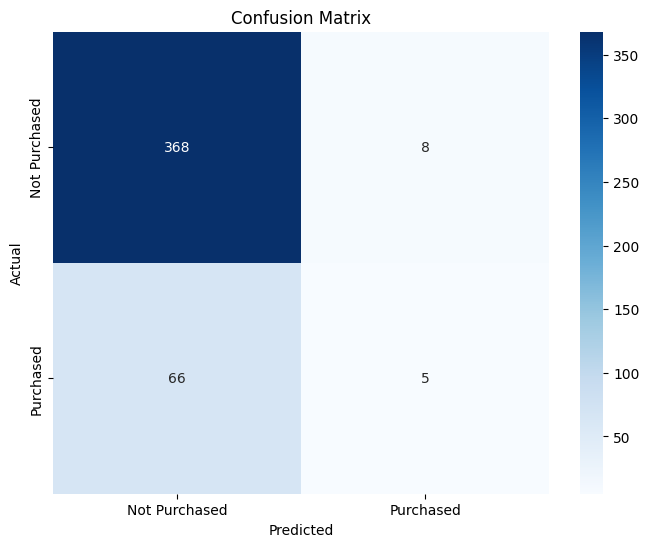


Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.98      0.91       376
           1       0.38      0.07      0.12        71

    accuracy                           0.83       447
   macro avg       0.62      0.52      0.51       447
weighted avg       0.77      0.83      0.78       447


Accuracy Score:
0.8344519015659956


In [41]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression()
holdOut_Validating(model, X_train_std, y_train, X_test_std, y_test)

### K-Fold Validation

##### Model from scratch

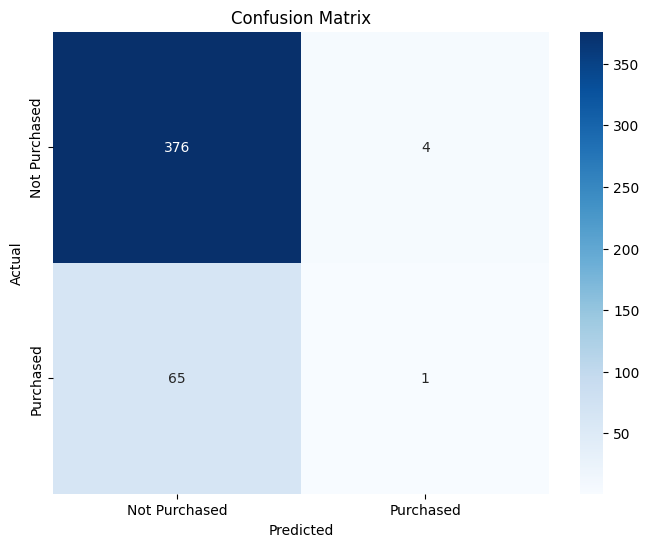

[[376   4]
 [ 65   1]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.85      0.99      0.92       380
           1       0.20      0.02      0.03        66

    accuracy                           0.85       446
   macro avg       0.53      0.50      0.47       446
weighted avg       0.76      0.85      0.78       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8503 (+/- 0.0057)


In [42]:
from supervised_learning.LogisticRegression import LogisticRegression
kFold_Validating(LogisticRegression(learnRate=0.001, iteration=11000, regTerm='l2', regLambda=0), np.vstack((X_train_std, X_test_std)), np.hstack((y_train, y_test)), folds=5)

##### Model Scikit-Learn

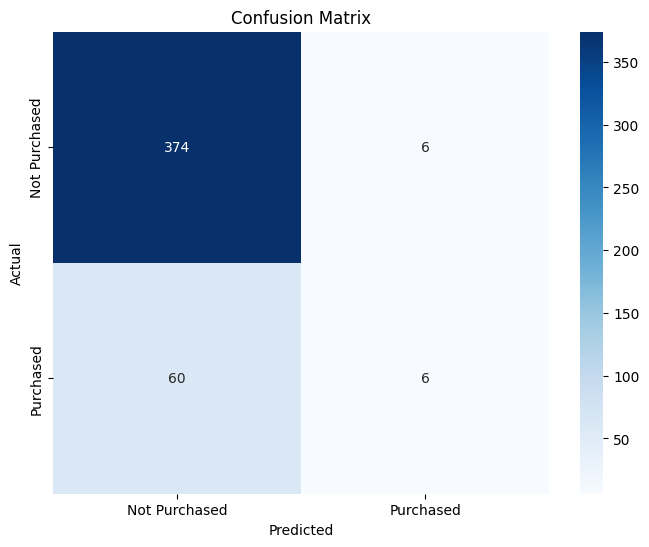

[[374   6]
 [ 60   6]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.86      0.98      0.92       380
           1       0.50      0.09      0.15        66

    accuracy                           0.85       446
   macro avg       0.68      0.54      0.54       446
weighted avg       0.81      0.85      0.81       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8503 (+/- 0.0066)


In [43]:
from sklearn.linear_model import LogisticRegression
kFold_Validating(LogisticRegression(max_iter=10000), np.vstack((X_train_std, X_test_std)), np.hstack((y_train, y_test)), folds=5)

### 3. Gaussian Naive Bayes
GNB menggunakan rasio probabilitas antar fitur.
Skala tidak terlalu berpengaruh karena model fokus pada distribusi probabilitas (mean & varian tiap fitur per kelas).

### Hold-out Validation
##### Model from scratch

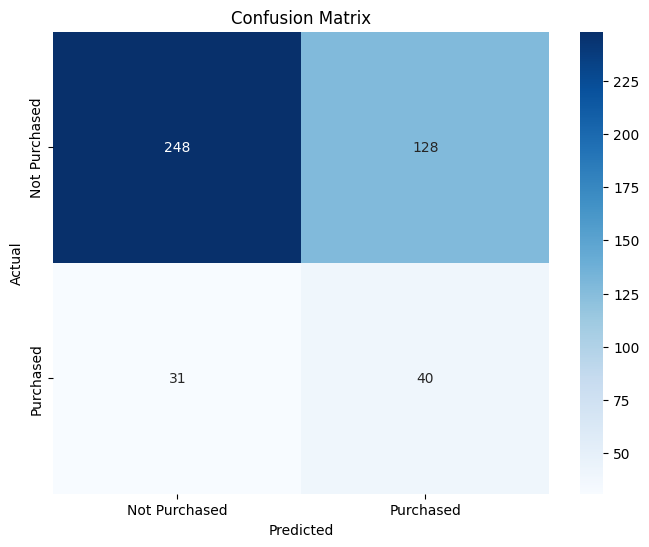


Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.66      0.76       376
           1       0.24      0.56      0.33        71

    accuracy                           0.64       447
   macro avg       0.56      0.61      0.55       447
weighted avg       0.79      0.64      0.69       447


Accuracy Score:
0.6442953020134228


In [44]:
from supervised_learning.GaussianNaiveBayes import GaussianNaiveBayes
modelScratch = GaussianNaiveBayes()
holdOut_Validating(modelScratch, X_train, y_train, X_test, y_test)

##### Model from scikit-learn

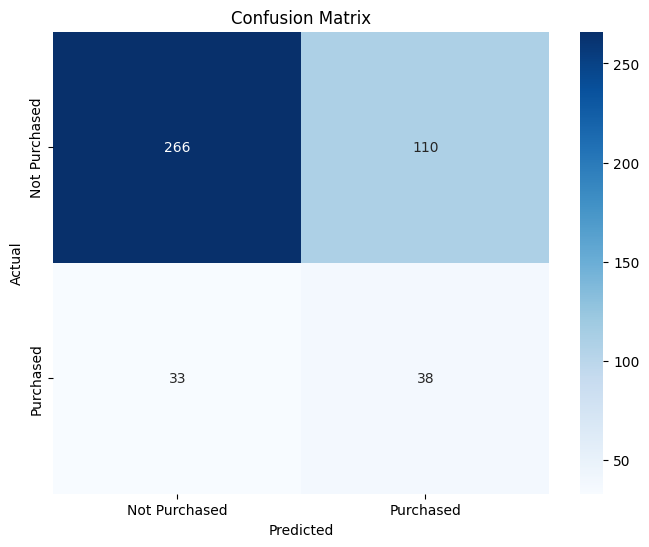


Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.71      0.79       376
           1       0.26      0.54      0.35        71

    accuracy                           0.68       447
   macro avg       0.57      0.62      0.57       447
weighted avg       0.79      0.68      0.72       447


Accuracy Score:
0.680089485458613


In [45]:
from sklearn.naive_bayes import GaussianNB
model = GaussianNB()
holdOut_Validating(model, X_train, y_train, X_test, y_test)

### K-Fold Validation
##### Model from scratch

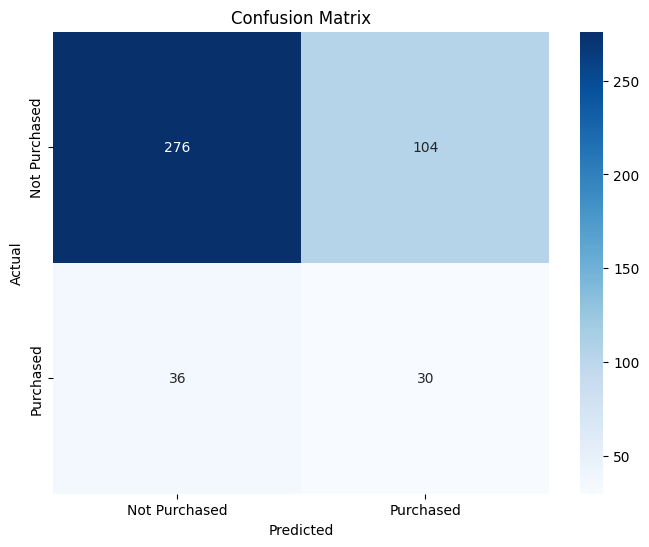

[[276 104]
 [ 36  30]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.88      0.73      0.80       380
           1       0.22      0.45      0.30        66

    accuracy                           0.69       446
   macro avg       0.55      0.59      0.55       446
weighted avg       0.79      0.69      0.72       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.6607 (+/- 0.0501)


In [46]:
from supervised_learning.GaussianNaiveBayes import GaussianNaiveBayes
modelScratch = GaussianNaiveBayes()
kFold_Validating(modelScratch, np.vstack((X_train_std, X_test_std)), np.hstack((y_train, y_test)), folds=5)

##### Model from Scikit-Learn

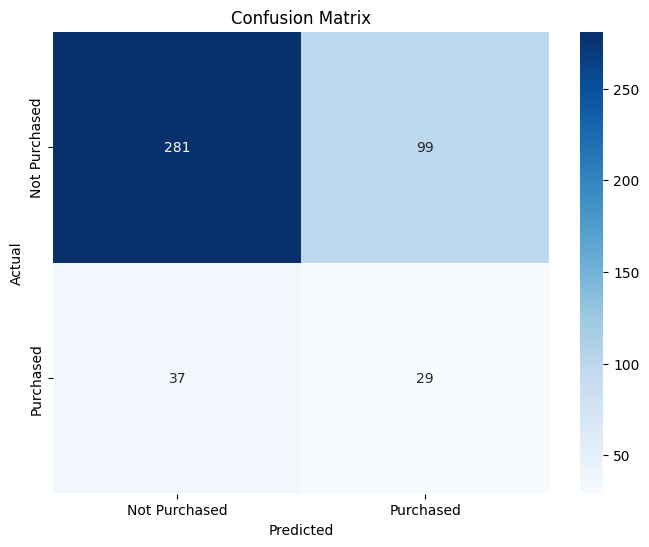

[[281  99]
 [ 37  29]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.88      0.74      0.81       380
           1       0.23      0.44      0.30        66

    accuracy                           0.70       446
   macro avg       0.56      0.59      0.55       446
weighted avg       0.79      0.70      0.73       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.6799 (+/- 0.0374)


In [47]:
from sklearn.naive_bayes import GaussianNB
model = GaussianNB()
kFold_Validating(model, np.vstack((X_train, X_test)), np.hstack((y_train, y_test)), folds=5)

### 4. Classification and Regression Tree (CART) : Classification
Tidak perlu scaling, Decision Tree membagi data dengan threshold pada satu fitur sehingga skala angka tidak memengaruhi proses split

### Hold-out Validation
##### Model from scratch

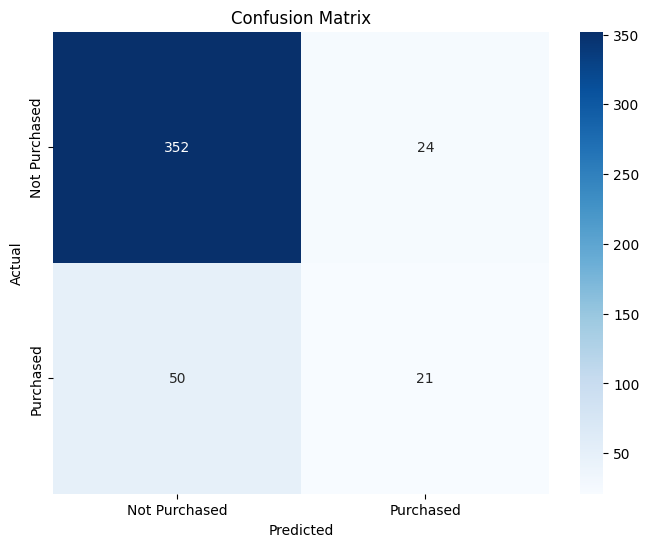


Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.94      0.90       376
           1       0.47      0.30      0.36        71

    accuracy                           0.83       447
   macro avg       0.67      0.62      0.63       447
weighted avg       0.81      0.83      0.82       447


Accuracy Score:
0.8344519015659956


In [48]:
from supervised_learning.CART import DecisionTree
model = DecisionTree(minDataSplit=100)
holdOut_Validating(model, X_train, y_train, X_test, y_test)

##### Model from Scikit-Learn

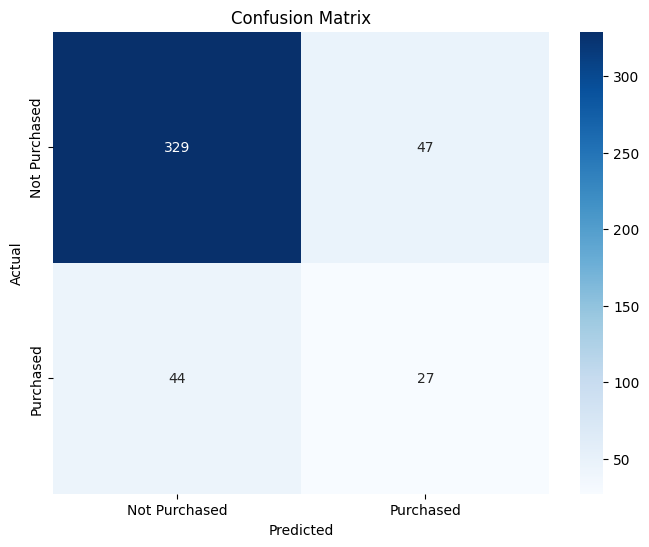


Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88       376
           1       0.36      0.38      0.37        71

    accuracy                           0.80       447
   macro avg       0.62      0.63      0.63       447
weighted avg       0.80      0.80      0.80       447


Accuracy Score:
0.796420581655481


In [49]:
from sklearn.tree import DecisionTreeClassifier
model = DecisionTreeClassifier()
holdOut_Validating(model, X_train, y_train, X_test, y_test)

### K-Fold Validation
##### Model from scratch

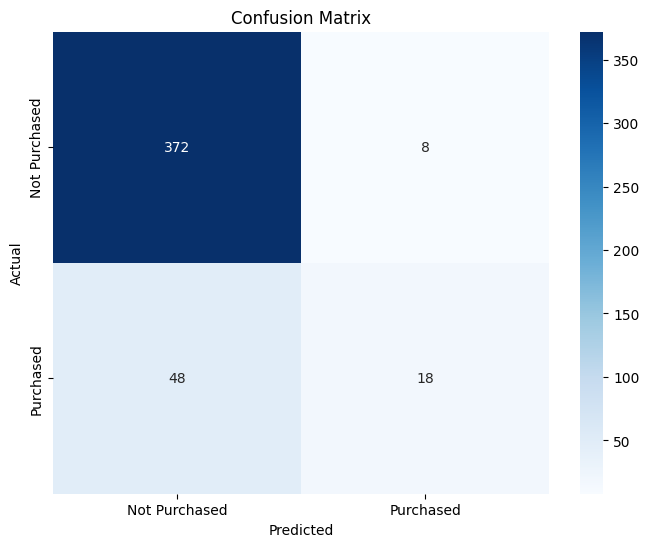

[[372   8]
 [ 48  18]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.89      0.98      0.93       380
           1       0.69      0.27      0.39        66

    accuracy                           0.87       446
   macro avg       0.79      0.63      0.66       446
weighted avg       0.86      0.87      0.85       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8548 (+/- 0.0119)


In [50]:
from supervised_learning.CART import DecisionTree
modelScratch = DecisionTree(minDataSplit=100)
kFold_Validating(modelScratch, np.vstack((X_train, X_test)), np.hstack((y_train, y_test)), folds=5)

##### Model from Scikit-Learn

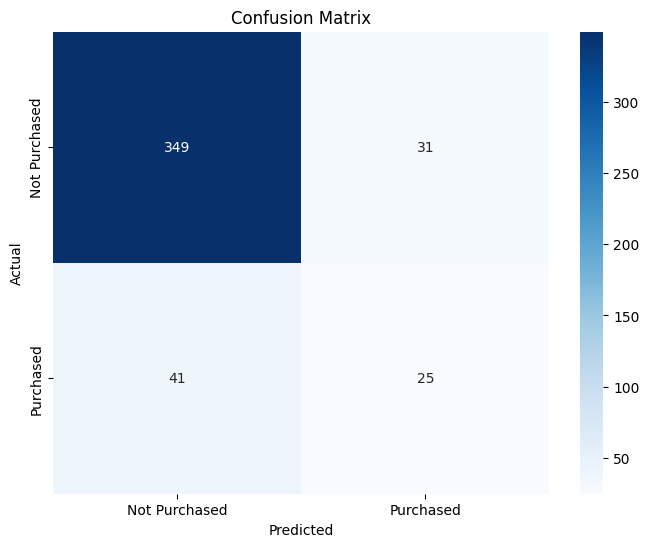

[[349  31]
 [ 41  25]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.89      0.92      0.91       380
           1       0.45      0.38      0.41        66

    accuracy                           0.84       446
   macro avg       0.67      0.65      0.66       446
weighted avg       0.83      0.84      0.83       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8234 (+/- 0.0159)


In [51]:
from sklearn.tree import DecisionTreeClassifier
model = DecisionTreeClassifier()
kFold_Validating(model, np.vstack((X_train, X_test)), np.hstack((y_train, y_test)), folds=5)

### 5. Support Vector Machine (SVM)
SVM bekerja dengan mencari hyperplane optimal.
Perhitungan margin (jarak antar titik dengan hyperplane) sangat sensitif terhadap skala fitur.
Dengan standarisasi, semua fitur diperlakukan setara, margin yang dihasilkan lebih adil.

### Hold-out Validation
##### Model from scratch

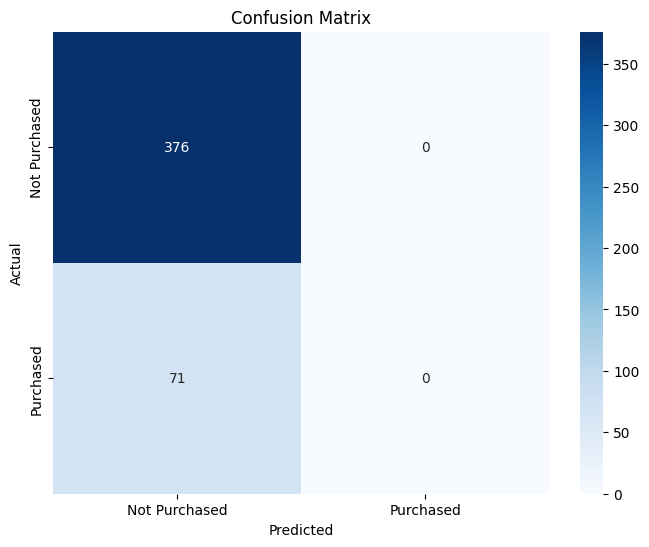


Classification Report:
              precision    recall  f1-score   support

           0       0.84      1.00      0.91       376
           1       0.00      0.00      0.00        71

    accuracy                           0.84       447
   macro avg       0.42      0.50      0.46       447
weighted avg       0.71      0.84      0.77       447


Accuracy Score:
0.8411633109619687


C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

In [52]:
from supervised_learning.SVM import SVM
from sklearn.preprocessing import StandardScaler
model = SVM()
holdOut_Validating(model, X_train_std, y_train, X_test_std, y_test)

##### Model from Scikit-Learn

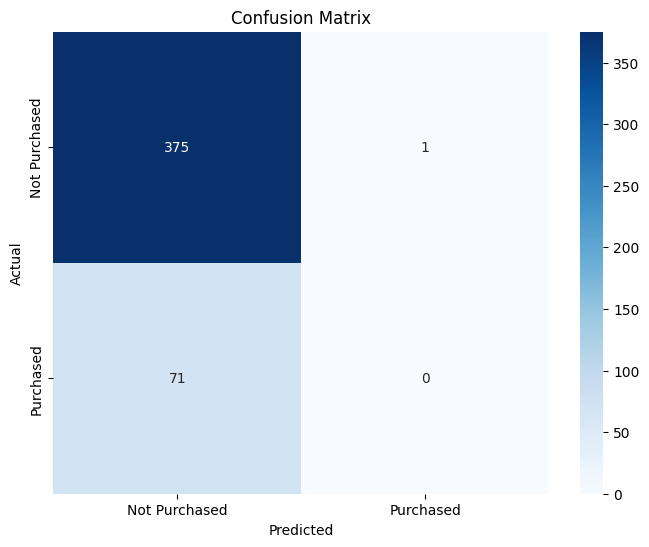


Classification Report:
              precision    recall  f1-score   support

           0       0.84      1.00      0.91       376
           1       0.00      0.00      0.00        71

    accuracy                           0.84       447
   macro avg       0.42      0.50      0.46       447
weighted avg       0.71      0.84      0.77       447


Accuracy Score:
0.8389261744966443


In [53]:
from sklearn.svm import SVC
model = SVC()
holdOut_Validating(model, X_train_std, y_train, X_test_std, y_test)

### K-Fold Validation
##### Model from scratch

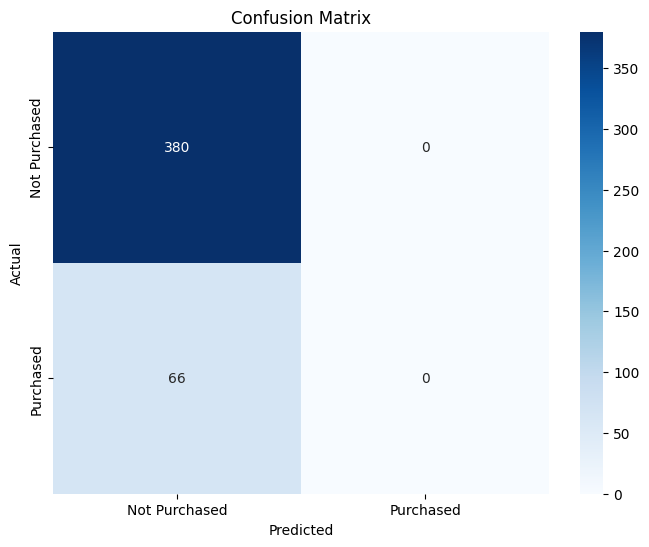

[[380   0]
 [ 66   0]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.85      1.00      0.92       380
           1       0.00      0.00      0.00        66

    accuracy                           0.85       446
   macro avg       0.43      0.50      0.46       446
weighted avg       0.73      0.85      0.78       446

--------------------------------------------------


C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i


Mean Accuracy across 5 folds: 0.8503 (+/- 0.0009)


In [54]:
from supervised_learning.SVM import SVM
model = SVM()
kFold_Validating(model, np.vstack((X_train_std, X_test_std)), np.hstack((y_train, y_test)), folds=5)

##### Model from Scikit-Learn

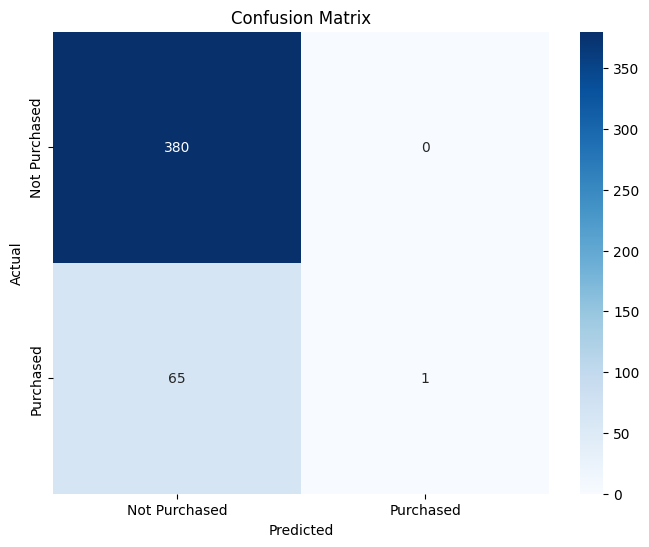

[[380   0]
 [ 65   1]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.85      1.00      0.92       380
           1       1.00      0.02      0.03        66

    accuracy                           0.85       446
   macro avg       0.93      0.51      0.48       446
weighted avg       0.88      0.85      0.79       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8525 (+/- 0.0026)


In [55]:
from sklearn.svm import SVC
model = SVC()
kFold_Validating(model, np.vstack((X_train_std, X_test_std)), np.hstack((y_train, y_test)), folds=5)

### 6. Artificial Neural Network (ANN)
Data di-normalisasi terlebih dahulu (Performa model terbukti meningkat), ANN menggunakan fungsi aktivasi (Sigmoid, Tanh, ReLU).
Jika input terlalu besar, fungsi aktivasi bisa saturasi (gradien ≈ 0), training melambat.
Normalisasi ke [0,1] atau [-1,1] menjaga input kecil sehingga gradien lebih stabil.

Tetapi pada praktiknya, data hasil standardisasi pun mendapat performa sama

### Hold-out Validation
##### Model from scratch

Epoch 0, Loss: 0.6912
Epoch 1000, Loss: 0.4160
Epoch 2000, Loss: 0.4027
Epoch 3000, Loss: 0.3926
Epoch 4000, Loss: 0.3852
Epoch 5000, Loss: 0.3796
Epoch 6000, Loss: 0.3748
Epoch 7000, Loss: 0.3707
Epoch 8000, Loss: 0.3673
Epoch 9000, Loss: 0.3644


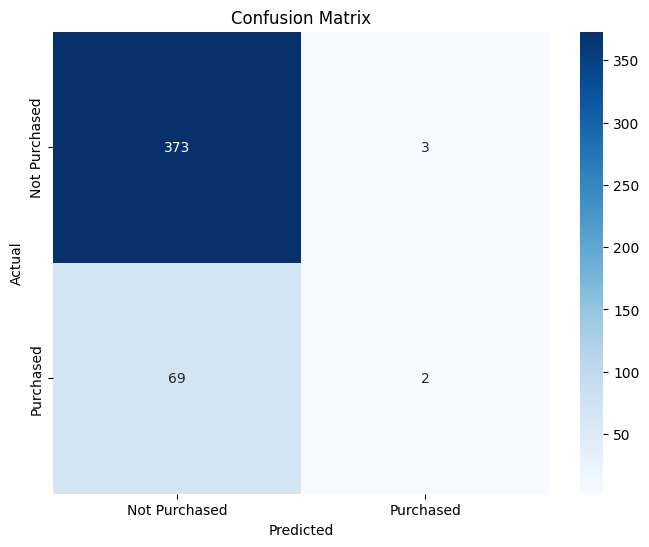


Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.99      0.91       376
           1       0.40      0.03      0.05        71

    accuracy                           0.84       447
   macro avg       0.62      0.51      0.48       447
weighted avg       0.77      0.84      0.78       447


Accuracy Score:
0.8389261744966443


In [56]:
from supervised_learning.ANN import ANN as ANN
model = ANN(
    layerDims=[24, 10, 1],
    activations=['relu', 'sigmoid'],
    lossFunction='binary_cross_entropy',
    epochs=10000,
    learningRate=0.01
)
holdOut_Validating(model, X_train_norm.T, y_train.T, X_test_norm.T, y_test.T)

##### Model from Scikit-Learn

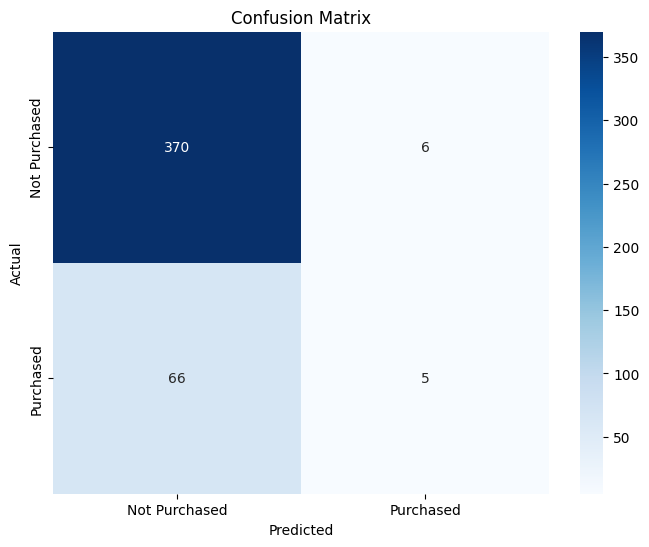


Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.98      0.91       376
           1       0.45      0.07      0.12        71

    accuracy                           0.84       447
   macro avg       0.65      0.53      0.52       447
weighted avg       0.79      0.84      0.79       447


Accuracy Score:
0.8389261744966443


In [57]:
from sklearn.neural_network import MLPClassifier
model = MLPClassifier(hidden_layer_sizes=(10,), learning_rate_init=0.01, max_iter=1000)
holdOut_Validating(model, X_train_norm, y_train, X_test_norm, y_test)

### K-Fold Validation
##### Model from scratch

Epoch 0, Loss: 0.6920
Epoch 1000, Loss: 0.5196
Epoch 2000, Loss: 0.4764
Epoch 3000, Loss: 0.4534
Epoch 4000, Loss: 0.4377
Epoch 5000, Loss: 0.4259
Epoch 6000, Loss: 0.4166
Epoch 7000, Loss: 0.4090
Epoch 8000, Loss: 0.4025
Epoch 9000, Loss: 0.3969
Epoch 0, Loss: 0.6923
Epoch 1000, Loss: 0.5200
Epoch 2000, Loss: 0.4764
Epoch 3000, Loss: 0.4524
Epoch 4000, Loss: 0.4358
Epoch 5000, Loss: 0.4234
Epoch 6000, Loss: 0.4137
Epoch 7000, Loss: 0.4059
Epoch 8000, Loss: 0.3994
Epoch 9000, Loss: 0.3939


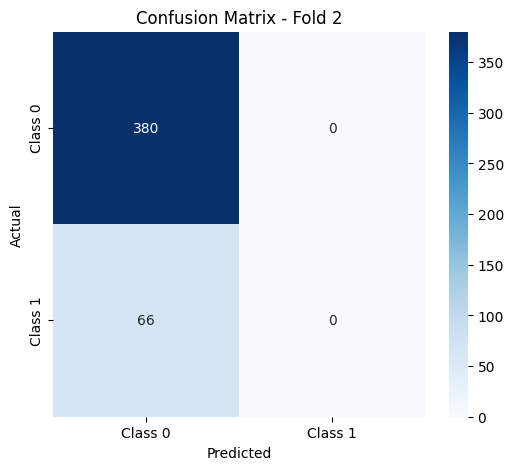

Fold 2 Report:
[[380   0]
 [ 66   0]]
              precision    recall  f1-score   support

           0       0.85      1.00      0.92       380
           1       0.00      0.00      0.00        66

    accuracy                           0.85       446
   macro avg       0.43      0.50      0.46       446
weighted avg       0.73      0.85      0.78       446

--------------------------------------------------
Epoch 0, Loss: 0.6922


C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\saman\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Epoch 1000, Loss: 0.5216
Epoch 2000, Loss: 0.4792
Epoch 3000, Loss: 0.4568
Epoch 4000, Loss: 0.4416
Epoch 5000, Loss: 0.4303
Epoch 6000, Loss: 0.4215
Epoch 7000, Loss: 0.4143
Epoch 8000, Loss: 0.4081
Epoch 9000, Loss: 0.4027
Epoch 0, Loss: 0.6923
Epoch 1000, Loss: 0.5213
Epoch 2000, Loss: 0.4766
Epoch 3000, Loss: 0.4528
Epoch 4000, Loss: 0.4368
Epoch 5000, Loss: 0.4252
Epoch 6000, Loss: 0.4163
Epoch 7000, Loss: 0.4092
Epoch 8000, Loss: 0.4033
Epoch 9000, Loss: 0.3983
Epoch 0, Loss: 0.6921
Epoch 1000, Loss: 0.5216
Epoch 2000, Loss: 0.4776
Epoch 3000, Loss: 0.4539
Epoch 4000, Loss: 0.4378
Epoch 5000, Loss: 0.4260
Epoch 6000, Loss: 0.4171
Epoch 7000, Loss: 0.4099
Epoch 8000, Loss: 0.4039
Epoch 9000, Loss: 0.3989

Mean Accuracy across 5 folds: 0.8503 (+/- 0.0009)


In [58]:
from supervised_learning.ANN import ANN as ANN
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

model_params = dict(
    layerDims=[24, 10, 1],
    activations=['relu', 'sigmoid'],
    lossFunction='binary_cross_entropy',
    epochs=10000,
    learningRate=0.001
)

X_all = np.vstack((X_train_std, X_test_std))   # (n_samples, n_features)
y_all = np.hstack((y_train, y_test))   # (n_samples,)

skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
all_acc = []
fold = 1

for train_idx, test_idx in skf.split(X_all, y_all):
    X_train, X_test = X_all[train_idx], X_all[test_idx]
    y_train, y_test = y_all[train_idx], y_all[test_idx]

    # Buat model ANN baru setiap fold
    model = ANN(**model_params)

    # Fit (ANN butuh input (features, samples))
    model.fit(X_train.T, y_train.reshape(1, -1))

    # Predict
    y_pred = model.predict(X_test.T).flatten()

    acc = accuracy_score(y_test, y_pred)
    all_acc.append(acc)

    if fold == 2:  # tampilkan confusion matrix utk fold tertentu
        conf_matrix = confusion_matrix(y_test, y_pred)
        plt.figure(figsize=(6, 5))
        sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
                    xticklabels=['Class 0', 'Class 1'],
                    yticklabels=['Class 0', 'Class 1'])
        plt.ylabel('Actual')
        plt.xlabel('Predicted')
        plt.title(f'Confusion Matrix - Fold {fold}')
        plt.show()

        print(f"Fold {fold} Report:")
        print(conf_matrix)
        print(classification_report(y_test, y_pred))
        print("-"*50)

    fold += 1

print(f"\nMean Accuracy across 5 folds: {np.mean(all_acc):.4f} (+/- {np.std(all_acc):.4f})")


##### Model from Scikit-Learn

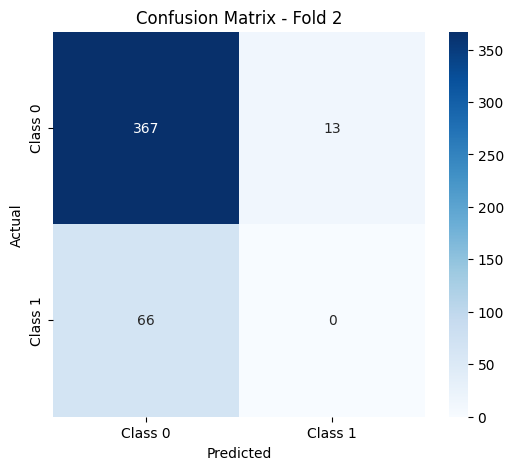

Fold 2 Report:
[[367  13]
 [ 66   0]]
              precision    recall  f1-score   support

           0       0.85      0.97      0.90       380
           1       0.00      0.00      0.00        66

    accuracy                           0.82       446
   macro avg       0.42      0.48      0.45       446
weighted avg       0.72      0.82      0.77       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8409 (+/- 0.0096)


In [59]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

model_params = dict(
    hidden_layer_sizes=(10,),
    learning_rate_init=0.01,
    max_iter=1000,
    random_state=42
)

X_all = np.vstack((X_train_std, X_test_std))   # (n_samples, n_features)
y_all = np.hstack((y_train, y_test))   # (n_samples,)

skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
all_acc = []
fold = 1

for train_idx, test_idx in skf.split(X_all, y_all):
    X_train, X_test = X_all[train_idx], X_all[test_idx]
    y_train, y_test = y_all[train_idx], y_all[test_idx]

    # model fresh tiap fold
    model = MLPClassifier(**model_params)

    # fit sklearn (tanpa transpose)
    model.fit(X_train, y_train)

    # predict
    y_pred = model.predict(X_test)

    acc = accuracy_score(y_test, y_pred)
    all_acc.append(acc)

    if fold == 2:
        conf_matrix = confusion_matrix(y_test, y_pred)
        plt.figure(figsize=(6, 5))
        sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
                    xticklabels=['Class 0', 'Class 1'],
                    yticklabels=['Class 0', 'Class 1'])
        plt.ylabel('Actual')
        plt.xlabel('Predicted')
        plt.title(f'Confusion Matrix - Fold {fold}')
        plt.show()

        print(f"Fold {fold} Report:")
        print(conf_matrix)
        print(classification_report(y_test, y_pred))
        print("-"*50)

    fold += 1

print(f"\nMean Accuracy across 5 folds: {np.mean(all_acc):.4f} (+/- {np.std(all_acc):.4f})")


### 7. Random Forest
Pakai data tanpa scaling, scaling tidak berpengaruh karena split hanya berdasarkan perbandingan nilai fitur (threshold).
### Hold-out Validation
##### Model from scratch

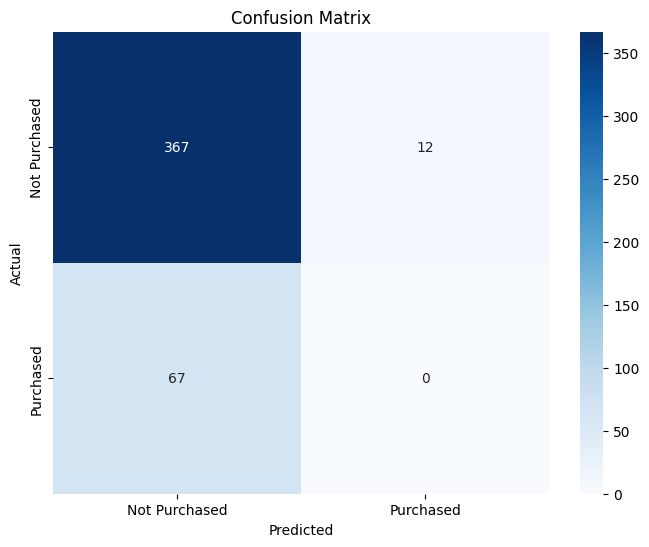


Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.97      0.90       379
           1       0.00      0.00      0.00        67

    accuracy                           0.82       446
   macro avg       0.42      0.48      0.45       446
weighted avg       0.72      0.82      0.77       446


Accuracy Score:
0.8228699551569507


In [60]:
from supervised_learning.RandomForest import RandomForest
model = RandomForest()
holdOut_Validating(model, X_train, y_train, X_test, y_test)

##### Model Sklearn

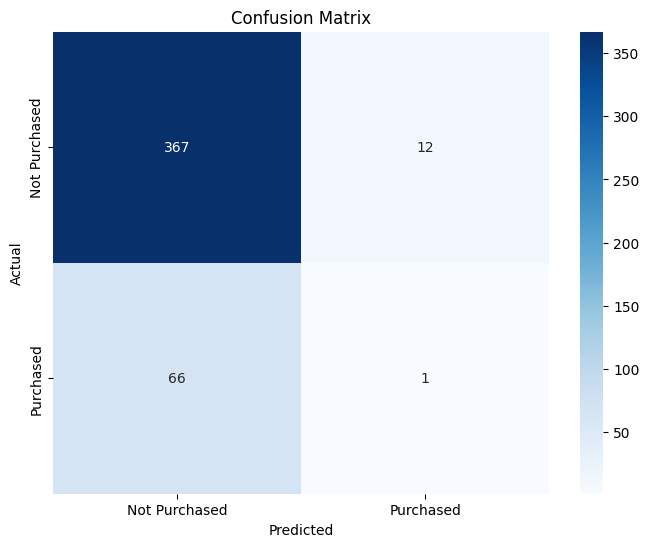


Classification Report:
              precision    recall  f1-score   support

           0       0.85      0.97      0.90       379
           1       0.08      0.01      0.03        67

    accuracy                           0.83       446
   macro avg       0.46      0.49      0.46       446
weighted avg       0.73      0.83      0.77       446


Accuracy Score:
0.8251121076233184


In [61]:
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier()
holdOut_Validating(model, X_train, y_train, X_test, y_test)

### K-Fold Validation
##### Model from scratch

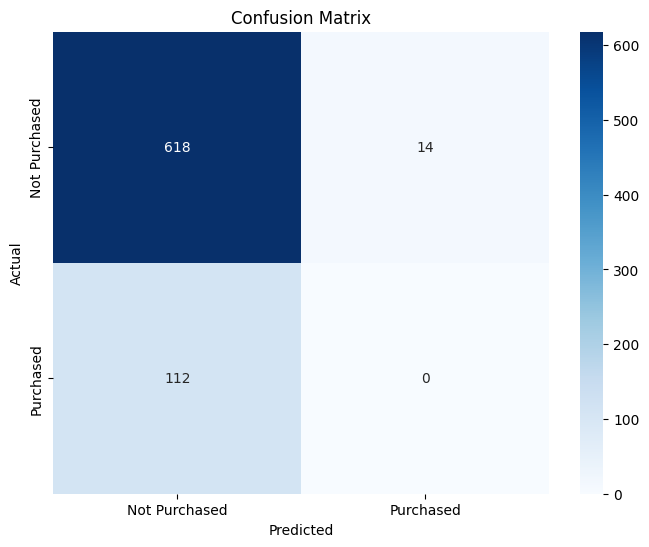

[[618  14]
 [112   0]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.85      0.98      0.91       632
           1       0.00      0.00      0.00       112

    accuracy                           0.83       744
   macro avg       0.42      0.49      0.45       744
weighted avg       0.72      0.83      0.77       744

--------------------------------------------------

Mean Accuracy across 3 folds: 0.8328 (+/- 0.0032)


In [62]:
from supervised_learning.RandomForest import RandomForest
model = RandomForest()
kFold_Validating(model, np.vstack((X_train, X_test)), np.hstack((y_train, y_test)), folds=3)

##### Model Sklearn

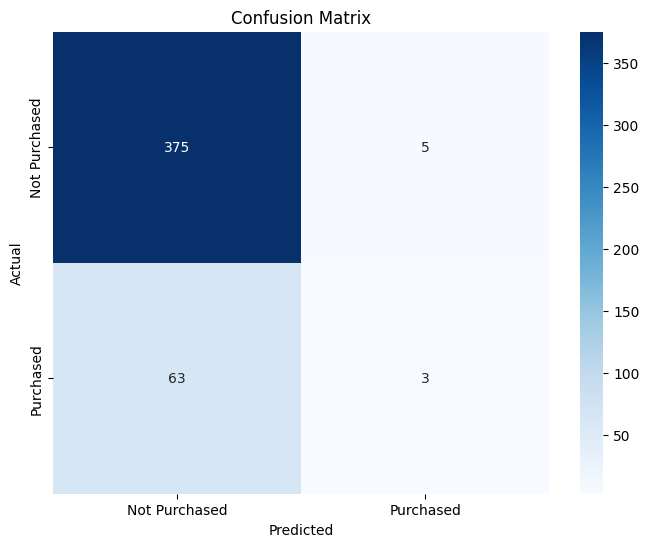

[[375   5]
 [ 63   3]]
Fold 2 Report:
              precision    recall  f1-score   support

           0       0.86      0.99      0.92       380
           1       0.38      0.05      0.08        66

    accuracy                           0.85       446
   macro avg       0.62      0.52      0.50       446
weighted avg       0.78      0.85      0.79       446

--------------------------------------------------

Mean Accuracy across 5 folds: 0.8292 (+/- 0.0108)


In [63]:
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier()
kFold_Validating(modelScratch, np.vstack((X_train, X_test)), np.hstack((y_train, y_test)), folds=5)